# FEA Bending Modes

In [1]:
import numpy as np
import pandas as pd
import scipy.io

import matplotlib.pyplot as plt

plt.jet()

%matplotlib inline

In [2]:
dataFolder = '/Users/bxin/Library/CloudStorage/OneDrive-SharedLibraries-GMTOCorp/M1S Portal - Documents'

#read SA data
dfSA = pd.read_excel(dataFolder+'/2.4 Utilities/03. Utilities Distribution/utility_mapping_M1B_labels-16-Feb-2023.xlsx')
sax = np.array(dfSA['x_m']) #in M1B
say = np.array(dfSA['y_m'])
saz = np.array(dfSA['z_m'])
saID = np.array(dfSA['LSNo'])
saReqMaxFx_N = np.array(dfSA['ReqMaxFx_N']) #max Fx the SA is allowed to produce??
print('N actuators = ', len(dfSA))

#read Afz (Fz influence matrix)
df = pd.read_csv(dataFolder+'/influnce_matrix_files/Afz-13-Apr-2023.csv', header=None)
Afz = np.array(df)
print('Afz = ',Afz.shape)
# this is Afz only; it is 27685 x 170.

#read Afx (Fx influence matrix)
df = pd.read_csv(dataFolder+'/influnce_matrix_files/Afx-24-Jul-2023.csv', header=None)
Afx = np.array(df)
print('Afx = ', Afx.shape)
#read Afy (Fy influence matrix)
df = pd.read_csv(dataFolder+'/influnce_matrix_files/Afy-24-Jul-2023.csv', header=None)
Afy = np.array(df)
print('Afy = ', Afy.shape)

#read Fz Bending Modes & forces
df = pd.read_csv(dataFolder+'/influnce_matrix_files/U-13-Apr-2023.csv', header=None)
UMat = np.array(df)
print('U matrix', UMat.shape)
df = pd.read_csv(dataFolder+'/influnce_matrix_files/V-13-Apr-2023.csv', header=None)
VMat = np.array(df)
print('V matrix', VMat.shape)
df = pd.read_csv(dataFolder+'/influnce_matrix_files/S-13-Apr-2023.csv', header=None)
SMat = np.array(df)
print('S matrix', SMat.shape)

#read FEA nodes data
mat = scipy.io.loadmat(dataFolder+'/influnce_matrix_files/NodeXYZsurface_meters.mat')
nodeID = mat['NodeXYZsurface_meters'][:,0]
nodex = mat['NodeXYZsurface_meters'][:,2] #swap x/y to get to M1B
nodey = mat['NodeXYZsurface_meters'][:,1]
nodez = mat['NodeXYZsurface_meters'][:,3]
print('N node = ', len(nodeID))

############normalize bending modes to RMS = 1um ###################
UMat *= np.sqrt(UMat.shape[0])
for modeID in range(1, UMat.shape[1]+1):
    VMat[:, modeID-1] *= 1e-6/SMat[modeID-1, modeID-1]*np.sqrt(UMat.shape[0]) 
    #1e-6 due to meter to micron conversion

N actuators =  170
Afz =  (27685, 170)
Afx =  (27685, 170)
Afy =  (27685, 170)
U matrix (27685, 170)
V matrix (170, 170)
S matrix (170, 170)
N node =  27685


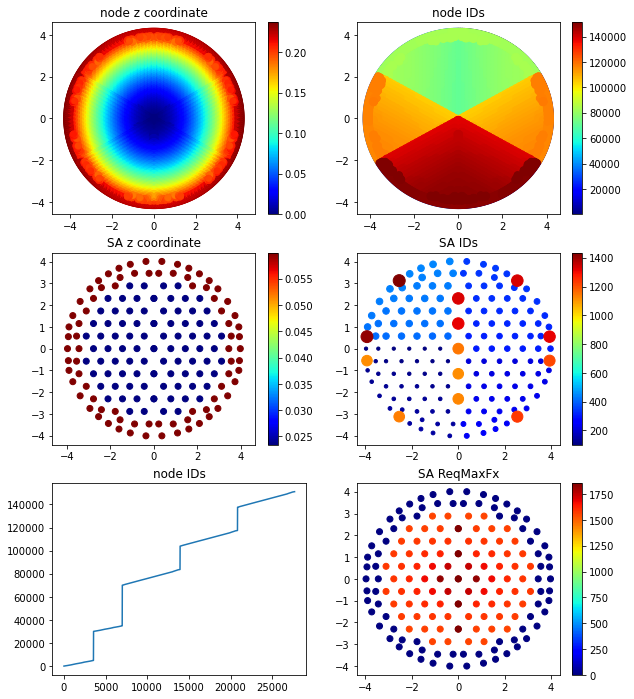

In [3]:
fig, ax = plt.subplots(3,2, figsize=(10,12))
img = ax[0][0].scatter(nodex, nodey, c=nodez)
fig.colorbar(img, ax=ax[0][0])
img = ax[0][1].scatter(nodex, nodey, c=nodeID)
fig.colorbar(img, ax=ax[0][1])
img = ax[1][1].scatter(sax, say, saID*0.1, c=saID)
fig.colorbar(img, ax=ax[1][1])
img = ax[1][0].scatter(sax, say, c=saz)
fig.colorbar(img, ax=ax[1][0])
img = ax[2][1].scatter(sax, say, c=saReqMaxFx_N)
fig.colorbar(img, ax=ax[2][1])
ax[2][0].plot(nodeID)
ax[0][0].set_title('node z coordinate')
ax[0][1].set_title('node IDs')
ax[1][0].set_title('SA z coordinate')
ax[1][1].set_title('SA IDs');
ax[2][0].set_title('node IDs')
ax[2][1].set_title('SA ReqMaxFx')
for i in range(3):
    for j in range(2):
        if not i==2 and j==0:
            ax[i][j].axis('equal')       

# In M1B, the 5 Quads are along y-axis !!! 

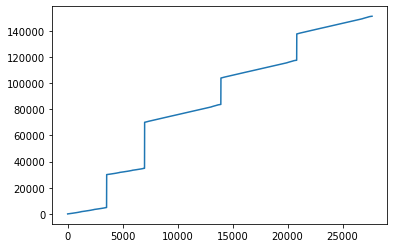

In [4]:
plt.plot(nodeID)

# Read in ML data so we can compare

In [6]:
dataFolder = '/Users/bxin/Library/CloudStorage/OneDrive-SharedLibraries-GMTOCorp/M1S Portal - Documents'

#read SA data
dfSA = scipy.io.loadmat(dataFolder+'/M1 Testing/RFCML Optical Testing/bending modes/actCoords.mat')
sax_ml = dfSA['yAct']/1e3 #turn into meter #swap x/y to get to M1B (M1DCS uses M1B!!!)
say_ml = dfSA['xAct']/1e3 #turn into meter
print('ML actuators = ', len(sax_ml), len(say_ml))

#read Afz (Fz influence matrix)
df = scipy.io.loadmat(dataFolder+'/M1 Testing/RFCML Optical Testing/bending modes/influenceFunctions.mat')
Afn_ml = df['interactionMat']
fv_ml = df['forceMat'] #fv = fv^T
print('Afn = ',Afn_ml.shape)
print('fv = ', fv_ml.shape)
# this is Afz only; it is 6991 x 170.

#read Fz Bending Mode 
mat = scipy.io.loadmat(dataFolder+'/M1 Testing/RFCML Optical Testing/bending modes/SVD.mat')
UMat_ml = mat['U']
SMat_ml = mat['S']
VMat_ml = mat['V']
print('U matrix', UMat_ml.shape)

#read FEA nodes data
mat = scipy.io.loadmat(dataFolder+'/M1 Testing/RFCML Optical Testing/bending modes/nodeCoords.mat')
nodex_ml = mat['y']/1e3 #turn into meter #swap x/y to get to M1B (M1DCS uses M1B!!!)
nodey_ml = mat['x']/1e3 #turn into meter
print('N node = ', len(nodex_ml))

############normalize bending modes to RMS = 1um ###################
UMat_ml *= np.sqrt(UMat_ml.shape[0])
for modeID in range(1, UMat_ml.shape[1]+1):
    VMat_ml[:, modeID-1] *= 1e3/SMat_ml[modeID-1, modeID-1]*np.sqrt(UMat_ml.shape[0]) 
    #1e3 due to nanometer to micron conversion; RFCML mode shapes are in nanometers

ML actuators =  165 165
Afn =  (6991, 165)
fv =  (165, 165)
U matrix (6991, 165)
N node =  6991


Text(0.5, 1.0, 'Actuator IDs and locations in M1-B Coordinate System')

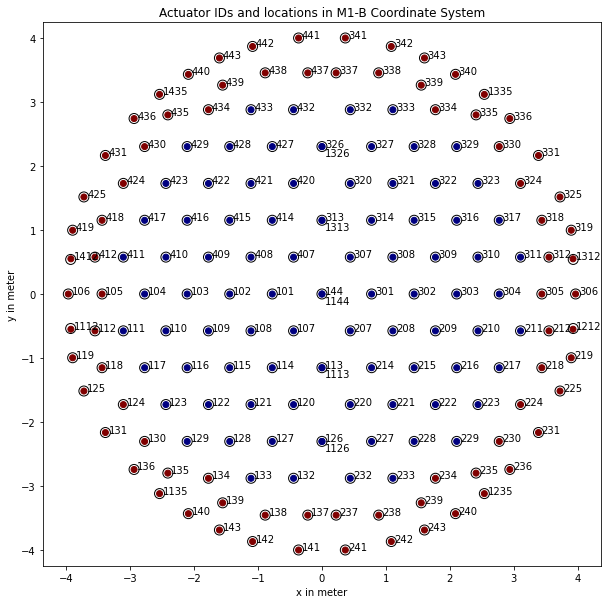

In [8]:
fig, ax = plt.subplots(1,1,figsize=(10,10))
plt.scatter(sax, say, c=saz)
plt.scatter(sax_ml, say_ml, s=100, facecolors='none', edgecolors='k')
for i in range(len(sax)):
    if (np.any(abs(sax[i]+say[i]-sax[:i]-say[:i])<1e-4)):
        plt.text(sax[i]+.05, say[i]-0.15, str(saID[i]))
    else:
        plt.text(sax[i]+.05, say[i], str(saID[i]))
plt.axis('equal')
plt.xlabel('x in meter')
plt.ylabel('y in meter')
plt.title('Actuator IDs and locations in M1-B Coordinate System')
#plt.grid()

In [9]:
saID_ml = np.zeros(len(sax_ml))
sa_offset = np.zeros(len(sax_ml))
for i in range(len(sax_ml)):
    found = (np.argmin(abs(sax_ml[i]+say_ml[i]-sax-say)))
    offset = np.hypot(sax_ml[i]-sax[found], say_ml[i]-say[found])
    #if found>0:
    saID_ml[i] = int(saID[found])
    sa_offset[i] = offset
        #print()
    #else:
    #    print(i, saID[i],sax_ml[i], say_ml[i], found, offset)
    #    print(((abs(sax_ml[i]+say_ml[i]-sax-say)<0.1)))

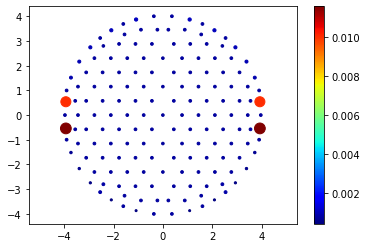

In [10]:
plt.scatter(sax_ml, say_ml, .1e5*sa_offset, c=sa_offset)
plt.axis('equal')
plt.colorbar();

In [12]:
saID

array([ 101,  102,  103,  104,  105,  106,  107,  108,  109,  110,  111,
        112,  114,  115,  116,  117,  118,  119,  120,  121,  122,  123,
        124,  125,  127,  128,  129,  130,  131,  132,  133,  134,  135,
        136,  137,  138,  139,  140,  141,  142,  143,  207,  208,  209,
        210,  211,  212,  214,  215,  216,  217,  218,  219,  220,  221,
        222,  223,  224,  225,  227,  228,  229,  230,  231,  232,  233,
        234,  235,  236,  237,  238,  239,  240,  241,  242,  243,  301,
        302,  303,  304,  305,  306,  307,  308,  309,  310,  311,  312,
        314,  315,  316,  317,  318,  319,  320,  321,  322,  323,  324,
        325,  327,  328,  329,  330,  331,  332,  333,  334,  335,  336,
        337,  338,  339,  340,  341,  342,  343,  407,  408,  409,  410,
        411,  412,  414,  415,  416,  417,  418,  419,  420,  421,  422,
        423,  424,  425,  427,  428,  429,  430,  431,  432,  433,  434,
        435,  436,  437,  438,  439,  440,  441,  4

In [13]:
saID_ml

array([ 443.,  419.,  143.,  119.,  412.,  112., 1435., 1135.,  441.,
        442.,  440.,  436.,  431.,  439.,  425.,  106.,  141.,  142.,
        140.,  136.,  131.,  139.,  125.,  407.,  420.,  432.,  437.,
        414.,  427.,  438.,  421.,  433.,  415.,  428.,  422.,  434.,
        416.,  429.,  435.,  423.,  417.,  430.,  424.,  408.,  409.,
        101.,  102.,  410.,  411., 1412.,  418.,  103.,  104.,  105.,
        107.,  120.,  132.,  137.,  114.,  127.,  138.,  121.,  133.,
        115.,  128.,  122.,  134.,  116.,  129.,  135.,  123.,  117.,
        130.,  124.,  108.,  109.,  110.,  111., 1112.,  118.,  144.,
        313.,  326.,  113.,  126.,  343.,  319.,  243.,  219.,  312.,
        212., 1335., 1235.,  341.,  342.,  340.,  336.,  331.,  339.,
        325.,  306.,  241.,  242.,  240.,  236.,  231.,  239.,  225.,
        307.,  320.,  332.,  337.,  314.,  327.,  338.,  321.,  333.,
        315.,  328.,  322.,  334.,  316.,  329.,  335.,  323.,  317.,
        330.,  324.,

In [14]:
np.savetxt('saID_ml.txt', saID_ml)

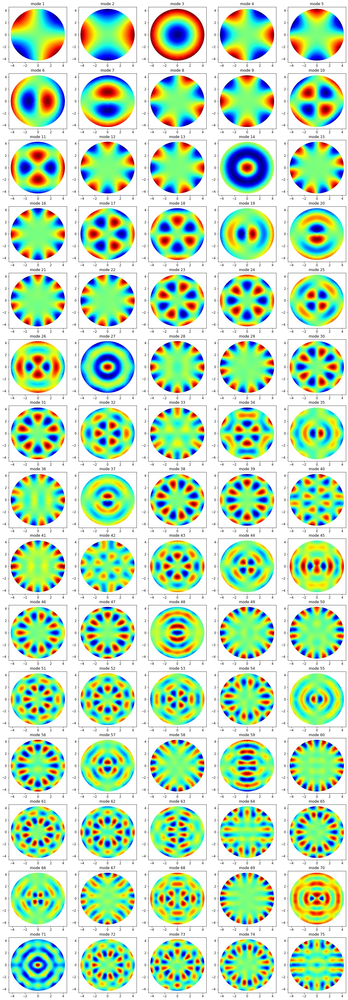

In [15]:
nrow = 15
fig, ax = plt.subplots(nrow,5,figsize=(20,4*nrow))
i = 0
for modeID in range(1,5*nrow+1):
    irow = np.int8(i/5)
    icol = np.mod(i,5)
    i += 1

    img = ax[irow][icol].scatter(nodex, nodey,10, UMat[:,modeID-1])
    ax[irow][icol].set_title('mode %d'%modeID)

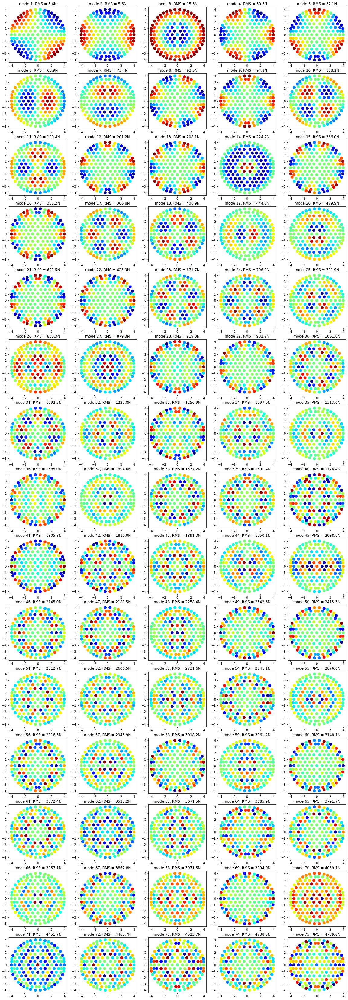

In [16]:
nrow = 15
fig, ax = plt.subplots(nrow,5,figsize=(20,4*nrow))
i = 0
for modeID in range(1,5*nrow+1):
    irow = np.int8(i/5)
    icol = np.mod(i,5)
    i += 1

    img = ax[irow][icol].scatter(sax, say,80, VMat[:,modeID-1])
    ax[irow][icol].set_title('mode %d, RMS = %.1fN'%(modeID, np.std(VMat[:,modeID-1])))

In [17]:
max(nodeID)

151119.0

# side by side comparison with ML bending modes

In [18]:
from scipy.interpolate import LinearNDInterpolator 
#we interpolate GMT BMs onto ML surface nodes to figure out any sign difference between the two sets of BMs

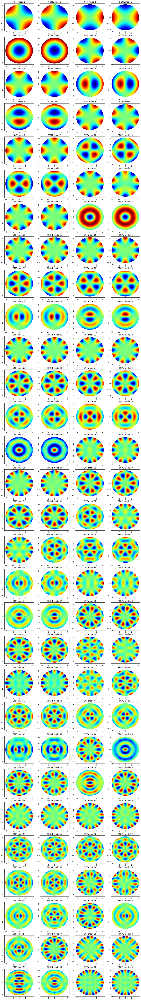

In [21]:
nrow = 30
fig, ax = plt.subplots(nrow,4,figsize=(16,4*nrow))
i = 0
for modeID in range(1,2*nrow+1):
    sign_flip = 1
    interp = LinearNDInterpolator(list(zip(nodex, nodey)), UMat[:, modeID-1], fill_value=0)
    mapOntoML = interp(nodex_ml, nodey_ml).ravel()
    if np.std(mapOntoML+UMat_ml[:,modeID-1])<np.std(UMat_ml[:,modeID-1]):
        sign_flip = -1 #-1 means we need to flip
    #print(sign_flip)
    for j in range(2):
        irow = np.int8(i/4)
        icol = np.mod(i,4)
        i += 1
        
        if j==0:
            img = ax[irow][icol].scatter(nodex, nodey,10, UMat[:,modeID-1]*sign_flip)
            ax[irow][icol].set_title('GMT mode %d'%modeID)
        else:
            img = ax[irow][icol].scatter(nodex_ml, nodey_ml,10, UMat_ml[:,modeID-1])
            ax[irow][icol].set_title('RFCML mode %d'%modeID)    

In [22]:
(UMat_ml[:,modeID-1]).shape

(6991,)

## GMT single SA IF (influenceMat * [0 0 1 0 0 ... 0])

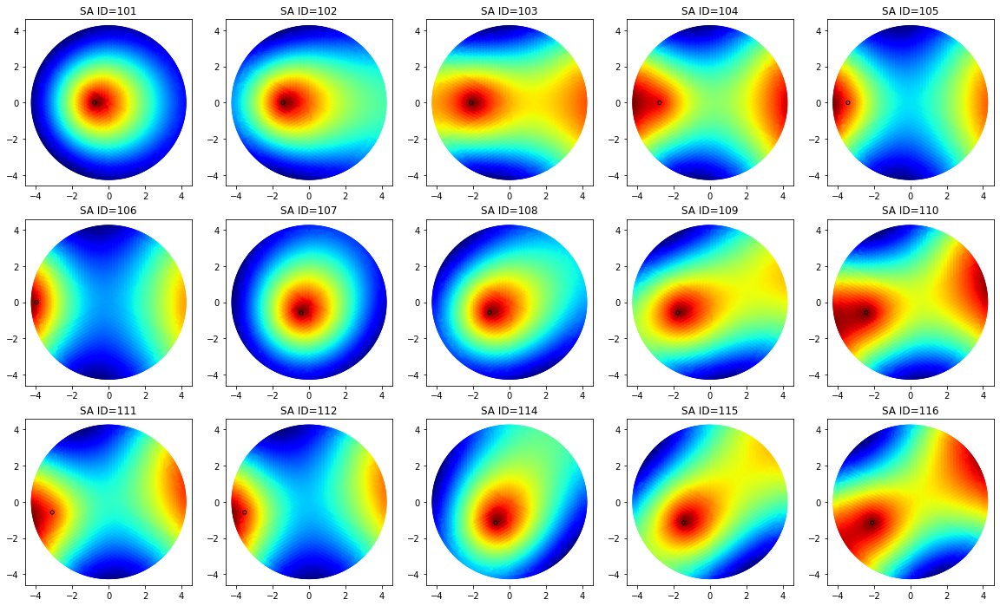

In [24]:
nrow = 3
fig, ax = plt.subplots(nrow,5,figsize=(20,4*nrow))
i = 0
for modeID in range(1,5*nrow+1):
    irow = np.int8(i/5)
    icol = np.mod(i,5)
    i += 1

    img = ax[irow][icol].scatter(nodex, nodey,10, Afz[:,modeID-1])
    ax[irow][icol].set_title('SA ID=%d'%(saID[modeID-1]))
    circle = plt.Circle((sax[modeID-1], say[modeID-1]),0.1, fill=False)
    ax[irow][icol].add_artist(circle)

## Side by side comparison with ML single SA IF

In [25]:
IF_ml = Afn_ml @ fv_ml

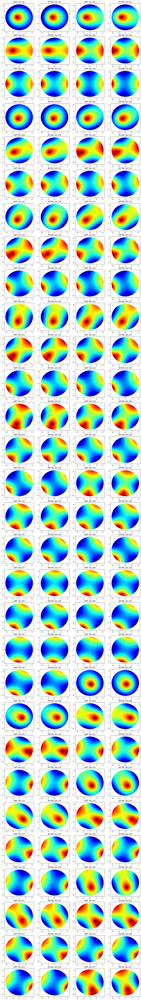

In [48]:
nrow = 30
fig, ax = plt.subplots(nrow,4,figsize=(16,4*nrow))
i = 0
for modeID in range(1,2*nrow+1):
    for j in range(2):
        irow = np.int8(i/4)
        icol = np.mod(i,4)
        i += 1
        
        if j==0:
            img = ax[irow][icol].scatter(nodex, nodey,10, Afz[:,modeID-1])
            ax[irow][icol].set_title('GMT SA %d'%saID[modeID-1])
            circle = plt.Circle((sax[modeID-1], say[modeID-1]),0.1, fill=False)
            ax[irow][icol].add_artist(circle)
        else:
            modeID_ml = np.where(saID_ml == saID[modeID-1])[0][0]+1 #we want modeID_ml to start from 1 as well
            img = ax[irow][icol].scatter(nodex_ml, nodey_ml,10, IF_ml[:,modeID_ml-1])
            ax[irow][icol].set_title('RFCML SA %d'%saID_ml[modeID_ml-1])   
            circle = plt.Circle((sax_ml[modeID_ml-1], say_ml[modeID_ml-1]),0.1, fill=False)
            ax[irow][icol].add_artist(circle)